### Imports

In [1]:
import pandas as pd
import numpy as np
import geopandas as gpd

In [2]:
import seaborn as sns
import matplotlib.pyplot as plt
import matplotlib as mpl
%matplotlib inline 
mpl.rcParams['figure.dpi'] = 300

In [3]:
from sklearn.preprocessing import Normalizer

In [4]:
pd.options.display.max_rows = 4000
pd.options.display.max_columns = 4000

### Setup

In [5]:
fig_dir = '../v2-fig/fig-cgis-no-eu/'

In [6]:
cgi_csv = '../data/v2/institutions_data_prepped.csv'

In [7]:
cgi_df = pd.read_csv(cgi_csv)

In [8]:
cgi_df.head()

,Institution_Name,Community_Name,Mechanism,Culture/Values/Norms,Notes,Time span,Time span: Start,Time span: End,Geography,Size,Source,Heterogeneity,enforcement_mechanisms_include_seizing_of_property,decision_making_mechanisms_include_public_meetings,decision_making_mechanisms_include_power_fluidity,decision_making_mechanisms_include_petition,decision_making_mechanisms_include_veto,decision_making_mechanisms_include_representation,decision_making_mechanisms_include_rule_of_law,enforcement_mechanisms_include_appeal,enforcement_mechanisms_include_tribunal_court_,decision_making_mechanisms_include_kingchief-as-figurehead,enforcement_mechanisms_include_destruction_of_property,decision_making_mechanisms_include_remunerated_position,decision_making_mechanisms_include_voting,enforcement_mechanisms_include_mediation,access_mechanisms_include_matrilineality,decision_making_mechanisms_include_ratification_acclamation_only,decision_making_mechanisms_include_checks_and_balances,enforcement_mechanisms_include_judicial_review,access_mechanisms_include_patronage_for_office,decision_making_mechanisms_include_plurality_voting,access_mechanisms_include_age_boundaries,enforcement_mechanisms_include_monitoring,decision_making_mechanisms_include_dual-sex_political_system,decision_making_mechanisms_include_word_of_mouth,decision_making_mechanisms_include_assembly_central,enforcement_mechanisms_include_graduated_sanctions,access_mechanisms_include_blood_relations,decision_making_mechanisms_include_agenda_setting,enforcement_mechanisms_include_suspension_expulsion_ostracism_proscription,decision_making_mechanisms_include_group_voting,decision_making_mechanisms_include_consent,decision_making_mechanisms_include_autocratic_leader_unbound,access_mechanisms_include_life_appointment,access_mechanisms_include_heredity,decision_making_mechanisms_include_coalition,decision_making_mechanisms_include_assembly_elite,decision_making_mechanisms_include_delegation,decision_making_mechanisms_include_quorum,access_mechanisms_include_popularity_,decision_making_mechanisms_include_leader_first_among_equals,decision_making_mechanisms_include_balance_of_power,access_mechanisms_include_divine_right,decision_making_mechanisms_include_vote_by_proxy,access_mechanisms_include_co-optation,decision_making_mechanisms_include_constitution,enforcement_mechanisms_include_capital_punishment,decision_making_mechanisms_include_autocratic_leader_chief_bound,enforcement_mechanisms_include_jury_judge,decision_making_mechanisms_include_turnover_rotation,access_mechanisms_include_female_participation,decision_making_mechanisms_include_consultation,enforcement_mechanisms_include_self-help,decision_making_mechanisms_include_oath,decision_making_mechanisms_include_supermajority,decision_making_mechanisms_include_council_central_,decision_making_mechanisms_include_lobbying,enforcement_mechanisms_include_police,decision_making_mechanisms_include_alliance,access_mechanisms_include_election,enforcement_mechanisms_include_reputational_risk,enforcement_mechanisms_include_paying_damages_compensation,access_mechanisms_include_screening_process,access_mechanisms_include_gerontocracy,access_mechanisms_include_payment_for_occupying_office,decision_making_mechanisms_include_board_committee,access_mechanisms_include_property_requirement,enforcement_mechanisms_include_negotiation,decision_making_mechanisms_include_secret_ballot,decision_making_mechanisms_include_gathering,enforcement_mechanisms_include_criticism_mocking_joking,decision_making_mechanisms_include_unanimity,decision_making_mechanisms_include_frequent_and_or_regular_meetings,decision_making_mechanisms_include_majority_voting,decision_making_mechanisms_include_consensus,decision_making_mechanisms_include_vote_by_show_of_hands,decision_making_mechanisms_include_bureaucracy,access_mechanisms_include_enfranchisement,enforcement_mechanisms_include_civil_disobedience,decision_making_mechanisms_include_assembly_local,access_mechanisms_include_open_po

In [9]:
# Drop Region: Europe
cgi_df = cgi_df[cgi_df['Region: Europe'] != 1]
cgi_df['Region: Europe'].sum()

0

In [10]:
cgi_df.head()

,Institution_Name,Community_Name,Mechanism,Culture/Values/Norms,Notes,Time span,Time span: Start,Time span: End,Geography,Size,Source,Heterogeneity,enforcement_mechanisms_include_seizing_of_property,decision_making_mechanisms_include_public_meetings,decision_making_mechanisms_include_power_fluidity,decision_making_mechanisms_include_petition,decision_making_mechanisms_include_veto,decision_making_mechanisms_include_representation,decision_making_mechanisms_include_rule_of_law,enforcement_mechanisms_include_appeal,enforcement_mechanisms_include_tribunal_court_,decision_making_mechanisms_include_kingchief-as-figurehead,enforcement_mechanisms_include_destruction_of_property,decision_making_mechanisms_include_remunerated_position,decision_making_mechanisms_include_voting,enforcement_mechanisms_include_mediation,access_mechanisms_include_matrilineality,decision_making_mechanisms_include_ratification_acclamation_only,decision_making_mechanisms_include_checks_and_balances,enforcement_mechanisms_include_judicial_review,access_mechanisms_include_patronage_for_office,decision_making_mechanisms_include_plurality_voting,access_mechanisms_include_age_boundaries,enforcement_mechanisms_include_monitoring,decision_making_mechanisms_include_dual-sex_political_system,decision_making_mechanisms_include_word_of_mouth,decision_making_mechanisms_include_assembly_central,enforcement_mechanisms_include_graduated_sanctions,access_mechanisms_include_blood_relations,decision_making_mechanisms_include_agenda_setting,enforcement_mechanisms_include_suspension_expulsion_ostracism_proscription,decision_making_mechanisms_include_group_voting,decision_making_mechanisms_include_consent,decision_making_mechanisms_include_autocratic_leader_unbound,access_mechanisms_include_life_appointment,access_mechanisms_include_heredity,decision_making_mechanisms_include_coalition,decision_making_mechanisms_include_assembly_elite,decision_making_mechanisms_include_delegation,decision_making_mechanisms_include_quorum,access_mechanisms_include_popularity_,decision_making_mechanisms_include_leader_first_among_equals,decision_making_mechanisms_include_balance_of_power,access_mechanisms_include_divine_right,decision_making_mechanisms_include_vote_by_proxy,access_mechanisms_include_co-optation,decision_making_mechanisms_include_constitution,enforcement_mechanisms_include_capital_punishment,decision_making_mechanisms_include_autocratic_leader_chief_bound,enforcement_mechanisms_include_jury_judge,decision_making_mechanisms_include_turnover_rotation,access_mechanisms_include_female_participation,decision_making_mechanisms_include_consultation,enforcement_mechanisms_include_self-help,decision_making_mechanisms_include_oath,decision_making_mechanisms_include_supermajority,decision_making_mechanisms_include_council_central_,decision_making_mechanisms_include_lobbying,enforcement_mechanisms_include_police,decision_making_mechanisms_include_alliance,access_mechanisms_include_election,enforcement_mechanisms_include_reputational_risk,enforcement_mechanisms_include_paying_damages_compensation,access_mechanisms_include_screening_process,access_mechanisms_include_gerontocracy,access_mechanisms_include_payment_for_occupying_office,decision_making_mechanisms_include_board_committee,access_mechanisms_include_property_requirement,enforcement_mechanisms_include_negotiation,decision_making_mechanisms_include_secret_ballot,decision_making_mechanisms_include_gathering,enforcement_mechanisms_include_criticism_mocking_joking,decision_making_mechanisms_include_unanimity,decision_making_mechanisms_include_frequent_and_or_regular_meetings,decision_making_mechanisms_include_majority_voting,decision_making_mechanisms_include_consensus,decision_making_mechanisms_include_vote_by_show_of_hands,decision_making_mechanisms_include_bureaucracy,access_mechanisms_include_enfranchisement,enforcement_mechanisms_include_civil_disobedience,decision_making_mechanisms_include_assembly_local,access_mechanisms_include_open_po

Note: CGI -> CGI *mechanisms*

In [11]:
cgi_only_df = cgi_df[cgi_df['CGI'].notna()]

In [12]:
cgi_only_df.head()

,Institution_Name,Community_Name,Mechanism,Culture/Values/Norms,Notes,Time span,Time span: Start,Time span: End,Geography,Size,Source,Heterogeneity,enforcement_mechanisms_include_seizing_of_property,decision_making_mechanisms_include_public_meetings,decision_making_mechanisms_include_power_fluidity,decision_making_mechanisms_include_petition,decision_making_mechanisms_include_veto,decision_making_mechanisms_include_representation,decision_making_mechanisms_include_rule_of_law,enforcement_mechanisms_include_appeal,enforcement_mechanisms_include_tribunal_court_,decision_making_mechanisms_include_kingchief-as-figurehead,enforcement_mechanisms_include_destruction_of_property,decision_making_mechanisms_include_remunerated_position,decision_making_mechanisms_include_voting,enforcement_mechanisms_include_mediation,access_mechanisms_include_matrilineality,decision_making_mechanisms_include_ratification_acclamation_only,decision_making_mechanisms_include_checks_and_balances,enforcement_mechanisms_include_judicial_review,access_mechanisms_include_patronage_for_office,decision_making_mechanisms_include_plurality_voting,access_mechanisms_include_age_boundaries,enforcement_mechanisms_include_monitoring,decision_making_mechanisms_include_dual-sex_political_system,decision_making_mechanisms_include_word_of_mouth,decision_making_mechanisms_include_assembly_central,enforcement_mechanisms_include_graduated_sanctions,access_mechanisms_include_blood_relations,decision_making_mechanisms_include_agenda_setting,enforcement_mechanisms_include_suspension_expulsion_ostracism_proscription,decision_making_mechanisms_include_group_voting,decision_making_mechanisms_include_consent,decision_making_mechanisms_include_autocratic_leader_unbound,access_mechanisms_include_life_appointment,access_mechanisms_include_heredity,decision_making_mechanisms_include_coalition,decision_making_mechanisms_include_assembly_elite,decision_making_mechanisms_include_delegation,decision_making_mechanisms_include_quorum,access_mechanisms_include_popularity_,decision_making_mechanisms_include_leader_first_among_equals,decision_making_mechanisms_include_balance_of_power,access_mechanisms_include_divine_right,decision_making_mechanisms_include_vote_by_proxy,access_mechanisms_include_co-optation,decision_making_mechanisms_include_constitution,enforcement_mechanisms_include_capital_punishment,decision_making_mechanisms_include_autocratic_leader_chief_bound,enforcement_mechanisms_include_jury_judge,decision_making_mechanisms_include_turnover_rotation,access_mechanisms_include_female_participation,decision_making_mechanisms_include_consultation,enforcement_mechanisms_include_self-help,decision_making_mechanisms_include_oath,decision_making_mechanisms_include_supermajority,decision_making_mechanisms_include_council_central_,decision_making_mechanisms_include_lobbying,enforcement_mechanisms_include_police,decision_making_mechanisms_include_alliance,access_mechanisms_include_election,enforcement_mechanisms_include_reputational_risk,enforcement_mechanisms_include_paying_damages_compensation,access_mechanisms_include_screening_process,access_mechanisms_include_gerontocracy,access_mechanisms_include_payment_for_occupying_office,decision_making_mechanisms_include_board_committee,access_mechanisms_include_property_requirement,enforcement_mechanisms_include_negotiation,decision_making_mechanisms_include_secret_ballot,decision_making_mechanisms_include_gathering,enforcement_mechanisms_include_criticism_mocking_joking,decision_making_mechanisms_include_unanimity,decision_making_mechanisms_include_frequent_and_or_regular_meetings,decision_making_mechanisms_include_majority_voting,decision_making_mechanisms_include_consensus,decision_making_mechanisms_include_vote_by_show_of_hands,decision_making_mechanisms_include_bureaucracy,access_mechanisms_include_enfranchisement,enforcement_mechanisms_include_civil_disobedience,decision_making_mechanisms_include_assembly_local,access_mechanisms_include_open_po

In [13]:
cgi_mechanisms_list = [x for x in cgi_only_df.columns if 'cgis_include_' in x]
cgi_mechanisms_list

['access_cgis_include_age_boundaries',
 'enforcement_cgis_include_criticism_mocking_joking',
 'enforcement_cgis_include_reputational_risk',
 'decision_making_cgis_include_assembly_elite',
 'enforcement_cgis_include_litigation',
 'decision_making_cgis_include_unanimity',
 'access_cgis_include_meritocracy',
 'enforcement_cgis_include_appeal',
 'decision_making_cgis_include_consultation',
 'decision_making_cgis_include_ratification_acclamation_only',
 'enforcement_cgis_include_exit',
 'decision_making_cgis_include_secret_ballot',
 'decision_making_cgis_include_turnover_rotation',
 'decision_making_cgis_include_supermajority',
 'decision_making_cgis_include_assembly_local',
 'decision_making_cgis_include_assembly_central',
 'enforcement_cgis_include_scrutiny_of_officials',
 'decision_making_cgis_include_council_central_',
 'enforcement_cgis_include_jury_judge',
 'decision_making_cgis_include_vote_by_proxy',
 'access_cgis_include_screening_process',
 'access_cgis_include_matriarchy',
 'deci

In [14]:
cgi_mechanisms_df = cgi_only_df[cgi_mechanisms_list]

In [15]:
cgi_mechanisms_df

,access_cgis_include_age_boundaries,enforcement_cgis_include_criticism_mocking_joking,enforcement_cgis_include_reputational_risk,decision_making_cgis_include_assembly_elite,enforcement_cgis_include_litigation,decision_making_cgis_include_unanimity,access_cgis_include_meritocracy,enforcement_cgis_include_appeal,decision_making_cgis_include_consultation,decision_making_cgis_include_ratification_acclamation_only,enforcement_cgis_include_exit,decision_making_cgis_include_secret_ballot,decision_making_cgis_include_turnover_rotation,decision_making_cgis_include_supermajority,decision_making_cgis_include_assembly_local,decision_making_cgis_include_assembly_central,enforcement_cgis_include_scrutiny_of_officials,decision_making_cgis_include_council_central_,enforcement_cgis_include_jury_judge,decision_making_cgis_include_vote_by_proxy,access_cgis_include_screening_process,access_cgis_include_matriarchy,decision_making_cgis_include_magistrate_official,enforcement_cgis_include_arbitration,access_cgis_include_lottery_random_selection,decision_making_cgis_include_public_meetings,decision_making_cgis_include_council_local,decision_making_cgis_include_veto,decision_making_cgis_include_deliberation,decision_making_cgis_include_agenda_setting,decision_making_cgis_include_delegation,decision_making_cgis_include_voting,decision_making_cgis_include_majority_voting,decision_making_cgis_include_vote_by_show_of_hands,decision_making_cgis_include_consensus,enforcement_cgis_include_suspension_expulsion_ostracism_proscription,decision_making_cgis_include_temporary_position_of_power_term_limits,decision_making_cgis_include_quorum,decision_making_cgis_include_gathering,enforcement_cgis_include_tribunal_court_,access_cgis_include_gerontocracy,decision_making_cgis_include_oath,access_cgis_include_election,access_cgis_include_popularity_,access_cgis_include_female_participation,decision_making_cgis_include_checks_and_balances,decision_making_cgis_include_consent,access_cgis_include_matrilineality,decision_making_cgis_include_representation,access_cgis_include_heredity,access_cgis_include_patronage_for_office,access_cgis_include_blood_relations,access_cgis_include_co-optation,decision_making_cgis_include_board_committee,decision_making_cgis_include_frequent_and_or_regular_meetings,access_cgis_include_property_requirement,access_cgis_include_payment_for_occupying_office,access_cgis_include_life_appointment,decision_making_cgis_include_remunerated_position,enforcement_cgis_include_judicial_review,decision_making_cgis_include_group_voting
2,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
14,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0
23,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
35,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
37,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
38,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
40,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
43,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
45,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,1,1,0,0,0,0,0,0,1,0,0,0,0
49,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0


In [18]:
cgi_mechanisms_df.sum().sort_values(ascending=False)

decision_making_cgis_include_council_central_                           25
decision_making_cgis_include_council_local                              25
decision_making_cgis_include_consensus                                  13
decision_making_cgis_include_deliberation                               13
decision_making_cgis_include_representation                             12
enforcement_cgis_include_tribunal_court_                                11
decision_making_cgis_include_assembly_central                           10
access_cgis_include_female_participation                                10
access_cgis_include_election                                             9
decision_making_cgis_include_consultation                                7
decision_making_cgis_include_assembly_local                              7
access_cgis_include_gerontocracy                                         7
decision_making_cgis_include_frequent_and_or_regular_meetings            7
decision_making_cgis_incl

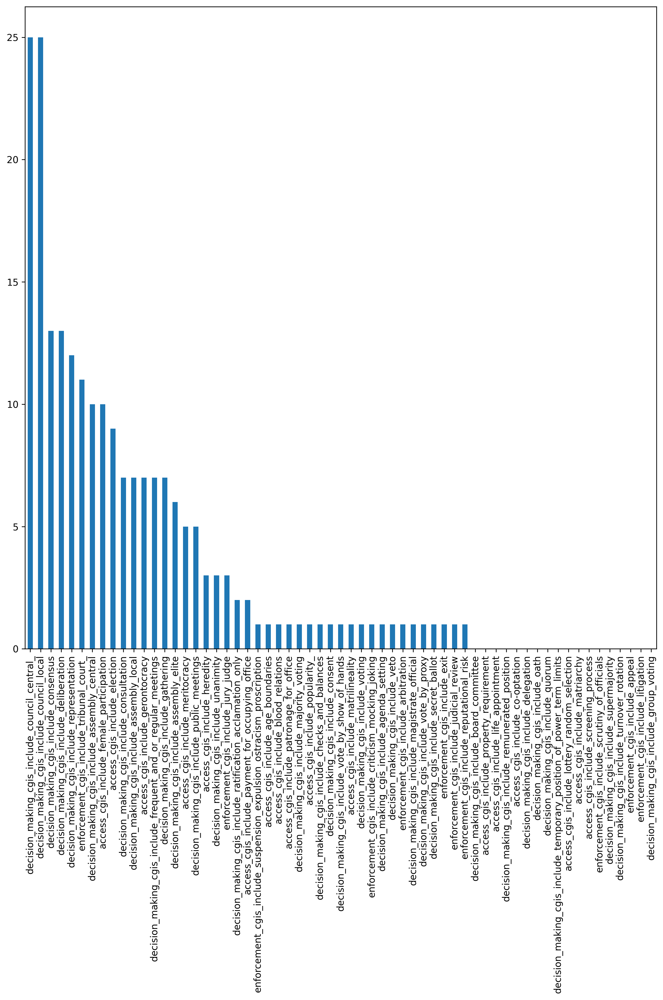

In [19]:
cgi_mechanisms_df.sum().sort_values(ascending=False).plot(kind='bar', figsize=(10,15))

plt.tight_layout()
plt.savefig(fig_dir + 'cgis_histogram.png')
plt.show()

TODO: 
  - comparative analysis b/n CGI mechanisms and non-CGI mechanisms

## By Mechanism category

In [20]:
access_cgis = [x for x in cgi_df.columns if 'access_cgis_' in x]

In [21]:
cgi_df[access_cgis]

,access_cgis_include_age_boundaries,access_cgis_include_meritocracy,access_cgis_include_screening_process,access_cgis_include_matriarchy,access_cgis_include_lottery_random_selection,access_cgis_include_gerontocracy,access_cgis_include_election,access_cgis_include_popularity_,access_cgis_include_female_participation,access_cgis_include_matrilineality,access_cgis_include_heredity,access_cgis_include_patronage_for_office,access_cgis_include_blood_relations,access_cgis_include_co-optation,access_cgis_include_property_requirement,access_cgis_include_payment_for_occupying_office,access_cgis_include_life_appointment
0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
2,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0
3,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
7,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
8,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
9,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
10,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
11,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
12,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0


<Axes: >

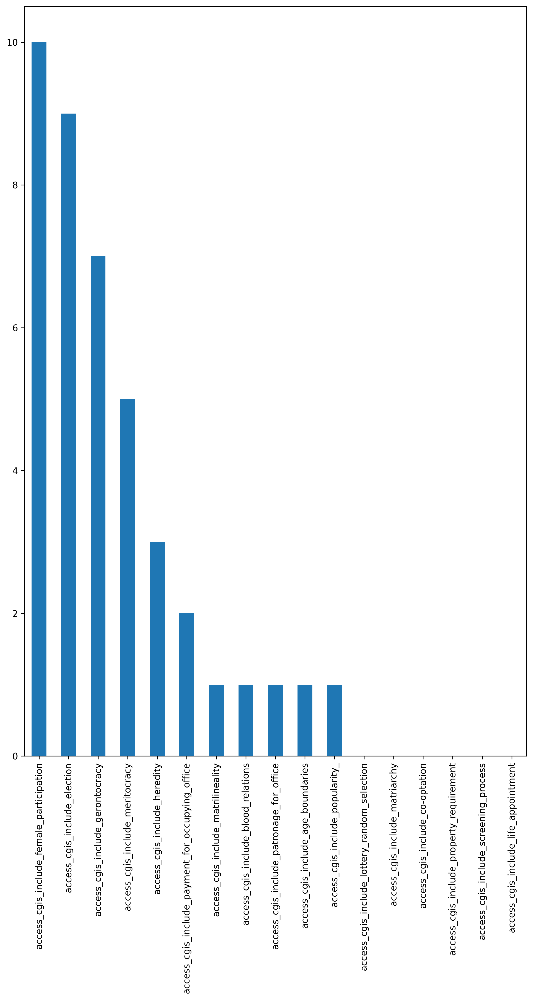

In [22]:
cgi_df[access_cgis].sum().sort_values(ascending=False).plot(kind='bar', figsize=(10,15))

In [23]:
decision_making_cgis = [x for x in cgi_df.columns if 'decision_making_cgis_' in x]

<Axes: >

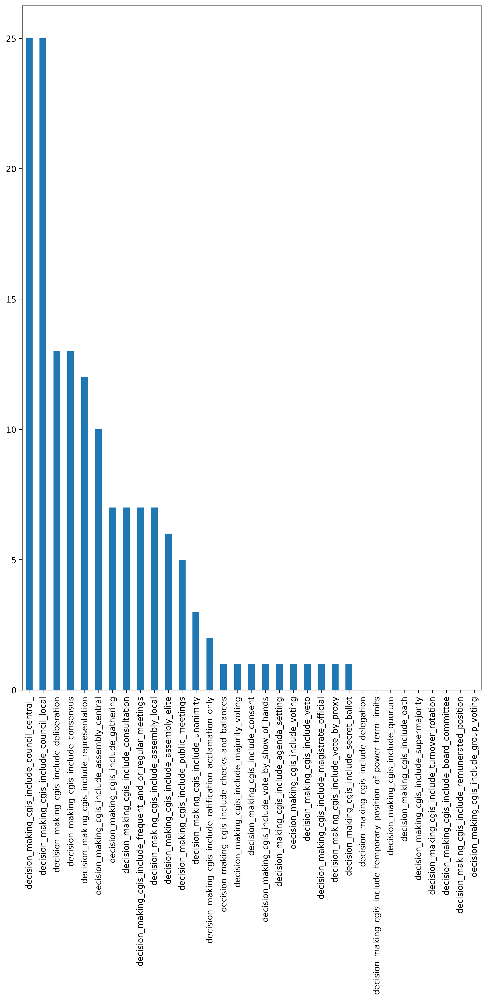

In [24]:
cgi_df[decision_making_cgis].sum().sort_values(ascending=False).plot(kind='bar', figsize=(10,15))

In [25]:
enforcement_cgis = [x for x in cgi_df.columns if 'enforcement_cgis_' in x]

<Axes: >

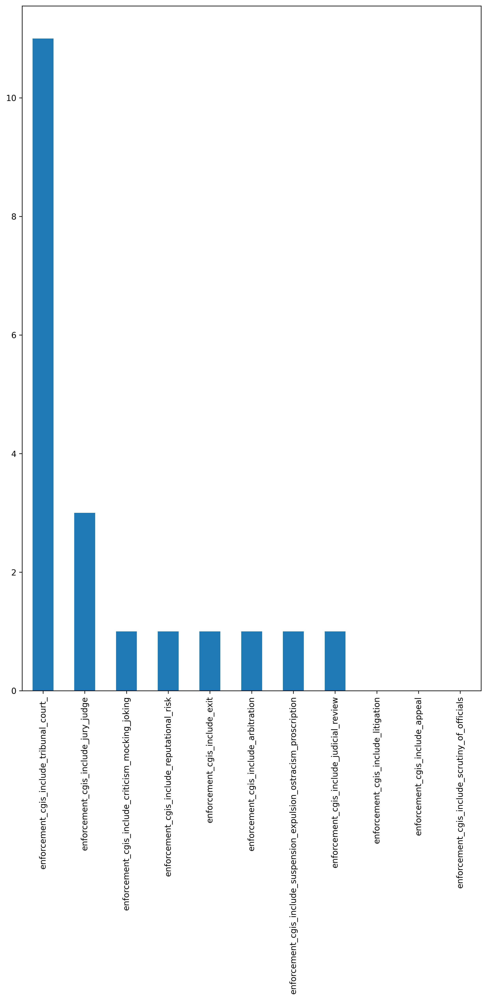

In [26]:
cgi_mechanisms_df[enforcement_cgis].sum().sort_values(ascending=False).plot(kind='bar', figsize=(10,15))

# CGI Mechanism Analysis 

In [27]:
# Select columns of interest

In [28]:
list(cgi_df)

['Institution_Name',
 'Community_Name',
 'Mechanism',
 'Culture/Values/Norms',
 'Notes',
 'Time span',
 'Time span: Start',
 'Time span: End',
 'Geography',
 'Size',
 'Source',
 'Heterogeneity ',
 'enforcement_mechanisms_include_seizing_of_property',
 'decision_making_mechanisms_include_public_meetings',
 'decision_making_mechanisms_include_power_fluidity',
 'decision_making_mechanisms_include_petition',
 'decision_making_mechanisms_include_veto',
 'decision_making_mechanisms_include_representation',
 'decision_making_mechanisms_include_rule_of_law',
 'enforcement_mechanisms_include_appeal',
 'enforcement_mechanisms_include_tribunal_court_',
 'decision_making_mechanisms_include_kingchief-as-figurehead',
 'enforcement_mechanisms_include_destruction_of_property',
 'decision_making_mechanisms_include_remunerated_position',
 'decision_making_mechanisms_include_voting',
 'enforcement_mechanisms_include_mediation',
 'access_mechanisms_include_matrilineality',
 'decision_making_mechanisms_inc

In [29]:
# Drop community mechanisms
mechanisms_list = [x for x in cgi_df.columns if x.startswith('mechanisms')]
mechanisms_list

[]

In [30]:
cgi_df.drop(columns=mechanisms_list, inplace=True)

In [31]:
list(cgi_df)

['Institution_Name',
 'Community_Name',
 'Mechanism',
 'Culture/Values/Norms',
 'Notes',
 'Time span',
 'Time span: Start',
 'Time span: End',
 'Geography',
 'Size',
 'Source',
 'Heterogeneity ',
 'enforcement_mechanisms_include_seizing_of_property',
 'decision_making_mechanisms_include_public_meetings',
 'decision_making_mechanisms_include_power_fluidity',
 'decision_making_mechanisms_include_petition',
 'decision_making_mechanisms_include_veto',
 'decision_making_mechanisms_include_representation',
 'decision_making_mechanisms_include_rule_of_law',
 'enforcement_mechanisms_include_appeal',
 'enforcement_mechanisms_include_tribunal_court_',
 'decision_making_mechanisms_include_kingchief-as-figurehead',
 'enforcement_mechanisms_include_destruction_of_property',
 'decision_making_mechanisms_include_remunerated_position',
 'decision_making_mechanisms_include_voting',
 'enforcement_mechanisms_include_mediation',
 'access_mechanisms_include_matrilineality',
 'decision_making_mechanisms_inc

## Normalized Correlation Matrix

In [32]:
data_plot = cgi_df.select_dtypes(include=[np.number])

In [33]:
data_plot.describe()

,Time span: Start,Time span: End,enforcement_mechanisms_include_seizing_of_property,decision_making_mechanisms_include_public_meetings,decision_making_mechanisms_include_power_fluidity,decision_making_mechanisms_include_petition,decision_making_mechanisms_include_veto,decision_making_mechanisms_include_representation,decision_making_mechanisms_include_rule_of_law,enforcement_mechanisms_include_appeal,enforcement_mechanisms_include_tribunal_court_,decision_making_mechanisms_include_kingchief-as-figurehead,enforcement_mechanisms_include_destruction_of_property,decision_making_mechanisms_include_remunerated_position,decision_making_mechanisms_include_voting,enforcement_mechanisms_include_mediation,access_mechanisms_include_matrilineality,decision_making_mechanisms_include_ratification_acclamation_only,decision_making_mechanisms_include_checks_and_balances,enforcement_mechanisms_include_judicial_review,access_mechanisms_include_patronage_for_office,decision_making_mechanisms_include_plurality_voting,access_mechanisms_include_age_boundaries,enforcement_mechanisms_include_monitoring,decision_making_mechanisms_include_dual-sex_political_system,decision_making_mechanisms_include_word_of_mouth,decision_making_mechanisms_include_assembly_central,enforcement_mechanisms_include_graduated_sanctions,access_mechanisms_include_blood_relations,decision_making_mechanisms_include_agenda_setting,enforcement_mechanisms_include_suspension_expulsion_ostracism_proscription,decision_making_mechanisms_include_group_voting,decision_making_mechanisms_include_consent,decision_making_mechanisms_include_autocratic_leader_unbound,access_mechanisms_include_life_appointment,access_mechanisms_include_heredity,decision_making_mechanisms_include_coalition,decision_making_mechanisms_include_assembly_elite,decision_making_mechanisms_include_delegation,decision_making_mechanisms_include_quorum,access_mechanisms_include_popularity_,decision_making_mechanisms_include_leader_first_among_equals,decision_making_mechanisms_include_balance_of_power,access_mechanisms_include_divine_right,decision_making_mechanisms_include_vote_by_proxy,access_mechanisms_include_co-optation,decision_making_mechanisms_include_constitution,enforcement_mechanisms_include_capital_punishment,decision_making_mechanisms_include_autocratic_leader_chief_bound,enforcement_mechanisms_include_jury_judge,decision_making_mechanisms_include_turnover_rotation,access_mechanisms_include_female_participation,decision_making_mechanisms_include_consultation,enforcement_mechanisms_include_self-help,decision_making_mechanisms_include_oath,decision_making_mechanisms_include_supermajority,decision_making_mechanisms_include_council_central_,decision_making_mechanisms_include_lobbying,enforcement_mechanisms_include_police,decision_making_mechanisms_include_alliance,access_mechanisms_include_election,enforcement_mechanisms_include_reputational_risk,enforcement_mechanisms_include_paying_damages_compensation,access_mechanisms_include_screening_process,access_mechanisms_include_gerontocracy,access_mechanisms_include_payment_for_occupying_office,decision_making_mechanisms_include_board_committee,access_mechanisms_include_property_requirement,enforcement_mechanisms_include_negotiation,decision_making_mechanisms_include_secret_ballot,decision_making_mechanisms_include_gathering,enforcement_mechanisms_include_criticism_mocking_joking,decision_making_mechanisms_include_unanimity,decision_making_mechanisms_include_frequent_and_or_regular_meetings,decision_making_mechanisms_include_majority_voting,decision_making_mechanisms_include_consensus,decision_making_mechanisms_include_vote_by_show_of_hands,decision_making_mechanisms_include_bureaucracy,access_mechanisms_include_enfranchisement,enforcement_mechanisms_include_civil_disobedience,decision_making_mechanisms_include_assembly_local,access_mechanisms_include_open_political_unit,decision_making_mechanisms_include_deliberation,decision_making_mechanisms_include_temporary_position_

In [34]:
data_plot

In [35]:
normalized = Normalizer().fit_transform(data_plot)

norm_df = pd.DataFrame(normalized)
norm_df.columns = data_plot.columns
norm_corr = norm_df.corr()

norm_corr

,Time span: Start,Time span: End,enforcement_mechanisms_include_seizing_of_property,decision_making_mechanisms_include_public_meetings,decision_making_mechanisms_include_power_fluidity,decision_making_mechanisms_include_petition,decision_making_mechanisms_include_veto,decision_making_mechanisms_include_representation,decision_making_mechanisms_include_rule_of_law,enforcement_mechanisms_include_appeal,enforcement_mechanisms_include_tribunal_court_,decision_making_mechanisms_include_kingchief-as-figurehead,enforcement_mechanisms_include_destruction_of_property,decision_making_mechanisms_include_remunerated_position,decision_making_mechanisms_include_voting,enforcement_mechanisms_include_mediation,access_mechanisms_include_matrilineality,decision_making_mechanisms_include_ratification_acclamation_only,decision_making_mechanisms_include_checks_and_balances,enforcement_mechanisms_include_judicial_review,access_mechanisms_include_patronage_for_office,decision_making_mechanisms_include_plurality_voting,access_mechanisms_include_age_boundaries,enforcement_mechanisms_include_monitoring,decision_making_mechanisms_include_dual-sex_political_system,decision_making_mechanisms_include_word_of_mouth,decision_making_mechanisms_include_assembly_central,enforcement_mechanisms_include_graduated_sanctions,access_mechanisms_include_blood_relations,decision_making_mechanisms_include_agenda_setting,enforcement_mechanisms_include_suspension_expulsion_ostracism_proscription,decision_making_mechanisms_include_group_voting,decision_making_mechanisms_include_consent,decision_making_mechanisms_include_autocratic_leader_unbound,access_mechanisms_include_life_appointment,access_mechanisms_include_heredity,decision_making_mechanisms_include_coalition,decision_making_mechanisms_include_assembly_elite,decision_making_mechanisms_include_delegation,decision_making_mechanisms_include_quorum,access_mechanisms_include_popularity_,decision_making_mechanisms_include_leader_first_among_equals,decision_making_mechanisms_include_balance_of_power,access_mechanisms_include_divine_right,decision_making_mechanisms_include_vote_by_proxy,access_mechanisms_include_co-optation,decision_making_mechanisms_include_constitution,enforcement_mechanisms_include_capital_punishment,decision_making_mechanisms_include_autocratic_leader_chief_bound,enforcement_mechanisms_include_jury_judge,decision_making_mechanisms_include_turnover_rotation,access_mechanisms_include_female_participation,decision_making_mechanisms_include_consultation,enforcement_mechanisms_include_self-help,decision_making_mechanisms_include_oath,decision_making_mechanisms_include_supermajority,decision_making_mechanisms_include_council_central_,decision_making_mechanisms_include_lobbying,enforcement_mechanisms_include_police,decision_making_mechanisms_include_alliance,access_mechanisms_include_election,enforcement_mechanisms_include_reputational_risk,enforcement_mechanisms_include_paying_damages_compensation,access_mechanisms_include_screening_process,access_mechanisms_include_gerontocracy,access_mechanisms_include_payment_for_occupying_office,decision_making_mechanisms_include_board_committee,access_mechanisms_include_property_requirement,enforcement_mechanisms_include_negotiation,decision_making_mechanisms_include_secret_ballot,decision_making_mechanisms_include_gathering,enforcement_mechanisms_include_criticism_mocking_joking,decision_making_mechanisms_include_unanimity,decision_making_mechanisms_include_frequent_and_or_regular_meetings,decision_making_mechanisms_include_majority_voting,decision_making_mechanisms_include_consensus,decision_making_mechanisms_include_vote_by_show_of_hands,decision_making_mechanisms_include_bureaucracy,access_mechanisms_include_enfranchisement,enforcement_mechanisms_include_civil_disobedience,decision_making_mechanisms_include_assembly_local,access_mechanisms_include_open_political_unit,decision_making_mechanisms_include_deliberation,decision_making_mechanisms_include_temporary_position_

In [36]:
norm_corr.head()

,Time span: Start,Time span: End,enforcement_mechanisms_include_seizing_of_property,decision_making_mechanisms_include_public_meetings,decision_making_mechanisms_include_power_fluidity,decision_making_mechanisms_include_petition,decision_making_mechanisms_include_veto,decision_making_mechanisms_include_representation,decision_making_mechanisms_include_rule_of_law,enforcement_mechanisms_include_appeal,enforcement_mechanisms_include_tribunal_court_,decision_making_mechanisms_include_kingchief-as-figurehead,enforcement_mechanisms_include_destruction_of_property,decision_making_mechanisms_include_remunerated_position,decision_making_mechanisms_include_voting,enforcement_mechanisms_include_mediation,access_mechanisms_include_matrilineality,decision_making_mechanisms_include_ratification_acclamation_only,decision_making_mechanisms_include_checks_and_balances,enforcement_mechanisms_include_judicial_review,access_mechanisms_include_patronage_for_office,decision_making_mechanisms_include_plurality_voting,access_mechanisms_include_age_boundaries,enforcement_mechanisms_include_monitoring,decision_making_mechanisms_include_dual-sex_political_system,decision_making_mechanisms_include_word_of_mouth,decision_making_mechanisms_include_assembly_central,enforcement_mechanisms_include_graduated_sanctions,access_mechanisms_include_blood_relations,decision_making_mechanisms_include_agenda_setting,enforcement_mechanisms_include_suspension_expulsion_ostracism_proscription,decision_making_mechanisms_include_group_voting,decision_making_mechanisms_include_consent,decision_making_mechanisms_include_autocratic_leader_unbound,access_mechanisms_include_life_appointment,access_mechanisms_include_heredity,decision_making_mechanisms_include_coalition,decision_making_mechanisms_include_assembly_elite,decision_making_mechanisms_include_delegation,decision_making_mechanisms_include_quorum,access_mechanisms_include_popularity_,decision_making_mechanisms_include_leader_first_among_equals,decision_making_mechanisms_include_balance_of_power,access_mechanisms_include_divine_right,decision_making_mechanisms_include_vote_by_proxy,access_mechanisms_include_co-optation,decision_making_mechanisms_include_constitution,enforcement_mechanisms_include_capital_punishment,decision_making_mechanisms_include_autocratic_leader_chief_bound,enforcement_mechanisms_include_jury_judge,decision_making_mechanisms_include_turnover_rotation,access_mechanisms_include_female_participation,decision_making_mechanisms_include_consultation,enforcement_mechanisms_include_self-help,decision_making_mechanisms_include_oath,decision_making_mechanisms_include_supermajority,decision_making_mechanisms_include_council_central_,decision_making_mechanisms_include_lobbying,enforcement_mechanisms_include_police,decision_making_mechanisms_include_alliance,access_mechanisms_include_election,enforcement_mechanisms_include_reputational_risk,enforcement_mechanisms_include_paying_damages_compensation,access_mechanisms_include_screening_process,access_mechanisms_include_gerontocracy,access_mechanisms_include_payment_for_occupying_office,decision_making_mechanisms_include_board_committee,access_mechanisms_include_property_requirement,enforcement_mechanisms_include_negotiation,decision_making_mechanisms_include_secret_ballot,decision_making_mechanisms_include_gathering,enforcement_mechanisms_include_criticism_mocking_joking,decision_making_mechanisms_include_unanimity,decision_making_mechanisms_include_frequent_and_or_regular_meetings,decision_making_mechanisms_include_majority_voting,decision_making_mechanisms_include_consensus,decision_making_mechanisms_include_vote_by_show_of_hands,decision_making_mechanisms_include_bureaucracy,access_mechanisms_include_enfranchisement,enforcement_mechanisms_include_civil_disobedience,decision_making_mechanisms_include_assembly_local,access_mechanisms_include_open_political_unit,decision_making_mechanisms_include_deliberation,decision_making_mechanisms_include_temporary_position_

# Visualize and Sort CGI Correlations

In [37]:
plt.figure(figsize=(20,20))

# define the mask to set the values in the upper triangle to True
mask = np.triu(np.ones_like(norm_corr, dtype=np.bool))

triangle_heatmap = sns.heatmap(
    norm_corr, 
    mask=mask, 
    vmin=-1, 
    vmax=1, 
    annot=False, 
    cmap='BrBG', 
    xticklabels=1, 
    yticklabels=1)

triangle_heatmap.set_title('Triangle Correlation triangle_heatmap', fontdict={'fontsize':18}, pad=16);

plt.tight_layout()
plt.savefig(fig_dir + 'cgis_triangle_correlations.png')
plt.show()

/var/folders/v7/8x_7ty4j3m76hgg7tncks_kc0000gn/T/ipykernel_55465/3758718678.py:4: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  mask = np.triu(np.ones_like(norm_corr, dtype=np.bool))


In [ ]:
cgis_list = [x for x in cgi_df.columns if 'cgis_' in x]
cgis_list

In [ ]:
cgis_df = norm_corr[cgis_list]

In [40]:
cgis_df

,access_cgis_include_age_boundaries,enforcement_cgis_include_criticism_mocking_joking,enforcement_cgis_include_reputational_risk,decision_making_cgis_include_assembly_elite,enforcement_cgis_include_litigation,decision_making_cgis_include_unanimity,access_cgis_include_meritocracy,enforcement_cgis_include_appeal,decision_making_cgis_include_consultation,decision_making_cgis_include_ratification_acclamation_only,enforcement_cgis_include_exit,decision_making_cgis_include_secret_ballot,decision_making_cgis_include_turnover_rotation,decision_making_cgis_include_supermajority,decision_making_cgis_include_assembly_local,decision_making_cgis_include_assembly_central,enforcement_cgis_include_scrutiny_of_officials,decision_making_cgis_include_council_central_,enforcement_cgis_include_jury_judge,decision_making_cgis_include_vote_by_proxy,access_cgis_include_screening_process,access_cgis_include_matriarchy,decision_making_cgis_include_magistrate_official,enforcement_cgis_include_arbitration,access_cgis_include_lottery_random_selection,decision_making_cgis_include_public_meetings,decision_making_cgis_include_council_local,decision_making_cgis_include_veto,decision_making_cgis_include_deliberation,decision_making_cgis_include_agenda_setting,decision_making_cgis_include_delegation,decision_making_cgis_include_voting,decision_making_cgis_include_majority_voting,decision_making_cgis_include_vote_by_show_of_hands,decision_making_cgis_include_consensus,enforcement_cgis_include_suspension_expulsion_ostracism_proscription,decision_making_cgis_include_temporary_position_of_power_term_limits,decision_making_cgis_include_quorum,decision_making_cgis_include_gathering,enforcement_cgis_include_tribunal_court_,access_cgis_include_gerontocracy,decision_making_cgis_include_oath,access_cgis_include_election,access_cgis_include_popularity_,access_cgis_include_female_participation,decision_making_cgis_include_checks_and_balances,decision_making_cgis_include_consent,access_cgis_include_matrilineality,decision_making_cgis_include_representation,access_cgis_include_heredity,access_cgis_include_patronage_for_office,access_cgis_include_blood_relations,access_cgis_include_co-optation,decision_making_cgis_include_board_committee,decision_making_cgis_include_frequent_and_or_regular_meetings,access_cgis_include_property_requirement,access_cgis_include_payment_for_occupying_office,access_cgis_include_life_appointment,decision_making_cgis_include_remunerated_position,enforcement_cgis_include_judicial_review,decision_making_cgis_include_group_voting
Time span: Start,0.051561,0.051449,0.030108,-0.010748,NaN,0.016165,0.094421,NaN,-0.047856,-0.022093,0.040927,0.051561,NaN,NaN,-0.039142,-0.176579,NaN,-0.046644,-0.181723,0.051096,NaN,NaN,0.044218,0.051096,NaN,-0.026529,0.158898,0.051022,0.080224,0.030986,NaN,0.036701,0.051449,0.051561,0.157328,0.051449,NaN,NaN,0.066506,-0.059763,0.123385,NaN,-0.023289,0.049056,0.138875,0.028251,0.051561,0.030108,0.109912,0.073210,0.048772,0.029447,NaN,NaN,0.077444,NaN,0.038609,NaN,NaN,0.030986,NaN
Time span: End,0.039724,0.039830,0.049910,0.021538,NaN,0.014183,0.099676,NaN,-0.004151,-0.029011,0.046776,0.039724,NaN,NaN,-0.027411,-0.130258,NaN,-0.005917,-0.166640,0.040157,NaN,NaN,0.045130,0.040157,NaN,-0.010018,0.154533,0.040225,0.096200,0.049763,NaN,0.048369,0.039830,0.039724,0.162367,0.039830,NaN,NaN,0.098168,-0.064336,0.112785,NaN,0.010306,0.041893,0.139946,0.050168,0.039724,0.049910,0.131893,0.076932,0.042115,0.050010,NaN,NaN,0.075996,NaN,0.070650,NaN,NaN,0.049763,NaN
enforcement_mechanisms_include_seizing_of_property,-0.010401,-0.010401,-0.010401,-0.023825,NaN,-0.017843,-0.023253,NaN,-0.024773,-0.014414,-0.010401,-0.010401,NaN,NaN,-0.025343,-0.027878,NaN,0.021169,-0.017910,-0.010401,NaN,NaN,-0.010401,-0.010401,NaN,-0.020812,0.141590,-0.010401,-0.038080,-0.010401,NaN,-0.010401,-0.010401,-0.010401,0.093294,-0.010401,NaN,NaN,-0.025218,-0.034817,-0.027651,NaN,-0.024738,-0.010401,0.401437,-0.010401,-0.010401,-0.010401,-0.036224,-0.017983,-0.0104

In [41]:
query_cgis_df = cgis_df.transpose()

In [42]:
query_cgis_df.head()

,Time span: Start,Time span: End,enforcement_mechanisms_include_seizing_of_property,decision_making_mechanisms_include_public_meetings,decision_making_mechanisms_include_power_fluidity,decision_making_mechanisms_include_petition,decision_making_mechanisms_include_veto,decision_making_mechanisms_include_representation,decision_making_mechanisms_include_rule_of_law,enforcement_mechanisms_include_appeal,enforcement_mechanisms_include_tribunal_court_,decision_making_mechanisms_include_kingchief-as-figurehead,enforcement_mechanisms_include_destruction_of_property,decision_making_mechanisms_include_remunerated_position,decision_making_mechanisms_include_voting,enforcement_mechanisms_include_mediation,access_mechanisms_include_matrilineality,decision_making_mechanisms_include_ratification_acclamation_only,decision_making_mechanisms_include_checks_and_balances,enforcement_mechanisms_include_judicial_review,access_mechanisms_include_patronage_for_office,decision_making_mechanisms_include_plurality_voting,access_mechanisms_include_age_boundaries,enforcement_mechanisms_include_monitoring,decision_making_mechanisms_include_dual-sex_political_system,decision_making_mechanisms_include_word_of_mouth,decision_making_mechanisms_include_assembly_central,enforcement_mechanisms_include_graduated_sanctions,access_mechanisms_include_blood_relations,decision_making_mechanisms_include_agenda_setting,enforcement_mechanisms_include_suspension_expulsion_ostracism_proscription,decision_making_mechanisms_include_group_voting,decision_making_mechanisms_include_consent,decision_making_mechanisms_include_autocratic_leader_unbound,access_mechanisms_include_life_appointment,access_mechanisms_include_heredity,decision_making_mechanisms_include_coalition,decision_making_mechanisms_include_assembly_elite,decision_making_mechanisms_include_delegation,decision_making_mechanisms_include_quorum,access_mechanisms_include_popularity_,decision_making_mechanisms_include_leader_first_among_equals,decision_making_mechanisms_include_balance_of_power,access_mechanisms_include_divine_right,decision_making_mechanisms_include_vote_by_proxy,access_mechanisms_include_co-optation,decision_making_mechanisms_include_constitution,enforcement_mechanisms_include_capital_punishment,decision_making_mechanisms_include_autocratic_leader_chief_bound,enforcement_mechanisms_include_jury_judge,decision_making_mechanisms_include_turnover_rotation,access_mechanisms_include_female_participation,decision_making_mechanisms_include_consultation,enforcement_mechanisms_include_self-help,decision_making_mechanisms_include_oath,decision_making_mechanisms_include_supermajority,decision_making_mechanisms_include_council_central_,decision_making_mechanisms_include_lobbying,enforcement_mechanisms_include_police,decision_making_mechanisms_include_alliance,access_mechanisms_include_election,enforcement_mechanisms_include_reputational_risk,enforcement_mechanisms_include_paying_damages_compensation,access_mechanisms_include_screening_process,access_mechanisms_include_gerontocracy,access_mechanisms_include_payment_for_occupying_office,decision_making_mechanisms_include_board_committee,access_mechanisms_include_property_requirement,enforcement_mechanisms_include_negotiation,decision_making_mechanisms_include_secret_ballot,decision_making_mechanisms_include_gathering,enforcement_mechanisms_include_criticism_mocking_joking,decision_making_mechanisms_include_unanimity,decision_making_mechanisms_include_frequent_and_or_regular_meetings,decision_making_mechanisms_include_majority_voting,decision_making_mechanisms_include_consensus,decision_making_mechanisms_include_vote_by_show_of_hands,decision_making_mechanisms_include_bureaucracy,access_mechanisms_include_enfranchisement,enforcement_mechanisms_include_civil_disobedience,decision_making_mechanisms_include_assembly_local,access_mechanisms_include_open_political_unit,decision_making_mechanisms_include_deliberation,decision_making_mechanisms_include_temporary_position_

## Time x Region x Size for CGIs

In [43]:
time_span_cols = ['Time span: Start', 'Time span: End', 'Time span: Duration']

In [44]:
region_cols = [r for r in list(cgi_df) if 'Region: ' in r] 

In [45]:
size_cols = [
    'Size: 100 - 1,000',
    'Size: 1,001 - 10,000',
    'Size: 10,001 - 100,000',
    'Size: 100,001 - 1,000,000',
    'Size: 1,000,001 - 10,000,000',
    'Size: 10,000,000+',
    'Size: Unknown'
]

In [46]:
list(cgi_df.columns)

['Institution_Name',
 'Community_Name',
 'Mechanism',
 'Culture/Values/Norms',
 'Notes',
 'Time span',
 'Time span: Start',
 'Time span: End',
 'Geography',
 'Size',
 'Source',
 'Heterogeneity ',
 'enforcement_mechanisms_include_seizing_of_property',
 'decision_making_mechanisms_include_public_meetings',
 'decision_making_mechanisms_include_power_fluidity',
 'decision_making_mechanisms_include_petition',
 'decision_making_mechanisms_include_veto',
 'decision_making_mechanisms_include_representation',
 'decision_making_mechanisms_include_rule_of_law',
 'enforcement_mechanisms_include_appeal',
 'enforcement_mechanisms_include_tribunal_court_',
 'decision_making_mechanisms_include_kingchief-as-figurehead',
 'enforcement_mechanisms_include_destruction_of_property',
 'decision_making_mechanisms_include_remunerated_position',
 'decision_making_mechanisms_include_voting',
 'enforcement_mechanisms_include_mediation',
 'access_mechanisms_include_matrilineality',
 'decision_making_mechanisms_inc

## Time x CGIs

In [47]:
time_cgis = query_cgis_df[time_span_cols]
time_cgis

,Time span: Start,Time span: End,Time span: Duration
access_cgis_include_age_boundaries,0.051561,0.039724,-0.053153
enforcement_cgis_include_criticism_mocking_joking,0.051449,0.039830,-0.052446
enforcement_cgis_include_reputational_risk,0.030108,0.049910,0.051088
decision_making_cgis_include_assembly_elite,-0.010748,0.021538,0.102754
enforcement_cgis_include_litigation,NaN,NaN,NaN
decision_making_cgis_include_unanimity,0.016165,0.014183,-0.011350
access_cgis_include_meritocracy,0.094421,0.099676,-0.014544
enforcement_cgis_include_appeal,NaN,NaN,NaN
decision_making_cgis_include_consultation,-0.047856,-0.004151,0.149923
decision_making_cgis_include_ratification_acclamation_only,-0.022093,-0.029011,-0.014086


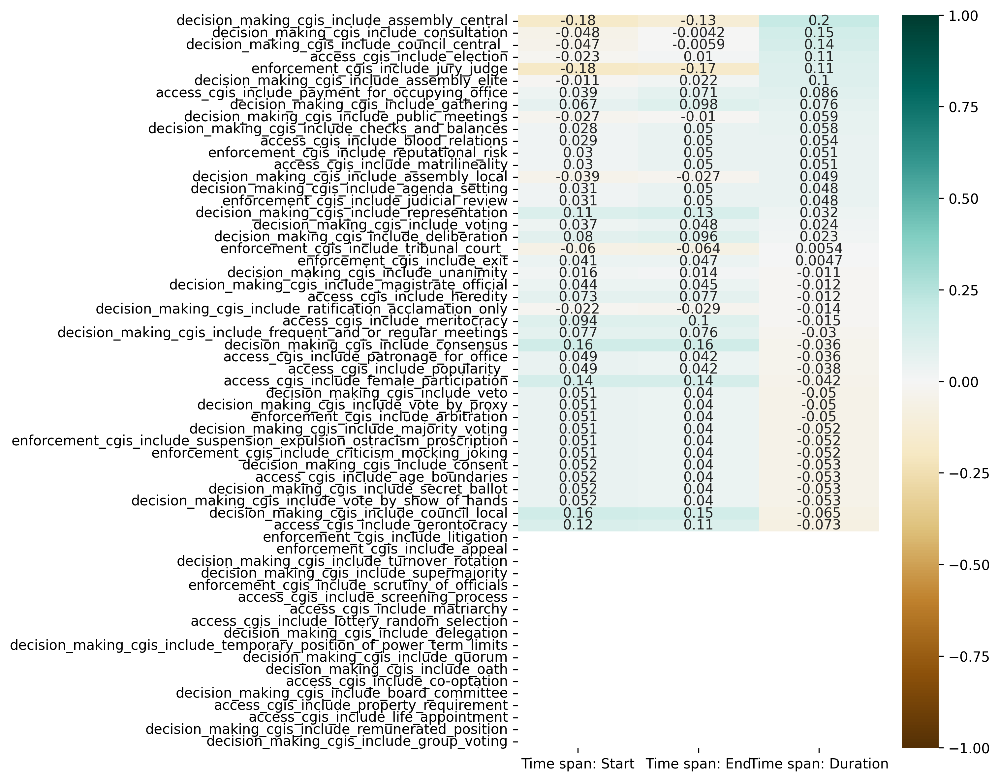

In [48]:
plt.figure(figsize=(10,8))

sns.heatmap(time_cgis.sort_values(by='Time span: Duration', ascending=False),
            vmin=-1, 
            vmax=1, 
            annot=True, 
            cmap='BrBG', 
            xticklabels=1, 
            yticklabels=1
)

plt.tight_layout()
plt.savefig(fig_dir + 'cgis_time.png')
plt.show()

### Time x CGIs: Access, Decision Making, Enforcement

In [49]:
access_cgis

['access_cgis_include_age_boundaries',
 'access_cgis_include_meritocracy',
 'access_cgis_include_screening_process',
 'access_cgis_include_matriarchy',
 'access_cgis_include_lottery_random_selection',
 'access_cgis_include_gerontocracy',
 'access_cgis_include_election',
 'access_cgis_include_popularity_',
 'access_cgis_include_female_participation',
 'access_cgis_include_matrilineality',
 'access_cgis_include_heredity',
 'access_cgis_include_patronage_for_office',
 'access_cgis_include_blood_relations',
 'access_cgis_include_co-optation',
 'access_cgis_include_property_requirement',
 'access_cgis_include_payment_for_occupying_office',
 'access_cgis_include_life_appointment']

In [50]:
time_access_cgis = time_cgis.loc[access_cgis]

In [51]:
time_access_cgis

,Time span: Start,Time span: End,Time span: Duration
access_cgis_include_age_boundaries,0.051561,0.039724,-0.053153
access_cgis_include_meritocracy,0.094421,0.099676,-0.014544
access_cgis_include_screening_process,NaN,NaN,NaN
access_cgis_include_matriarchy,NaN,NaN,NaN
access_cgis_include_lottery_random_selection,NaN,NaN,NaN
access_cgis_include_gerontocracy,0.123385,0.112785,-0.072701
access_cgis_include_election,-0.023289,0.010306,0.110852
access_cgis_include_popularity_,0.049056,0.041893,-0.037970
access_cgis_include_female_participation,0.138875,0.139946,-0.041860
access_cgis_include_matrilineality,0.030108,0.049910,0.051088


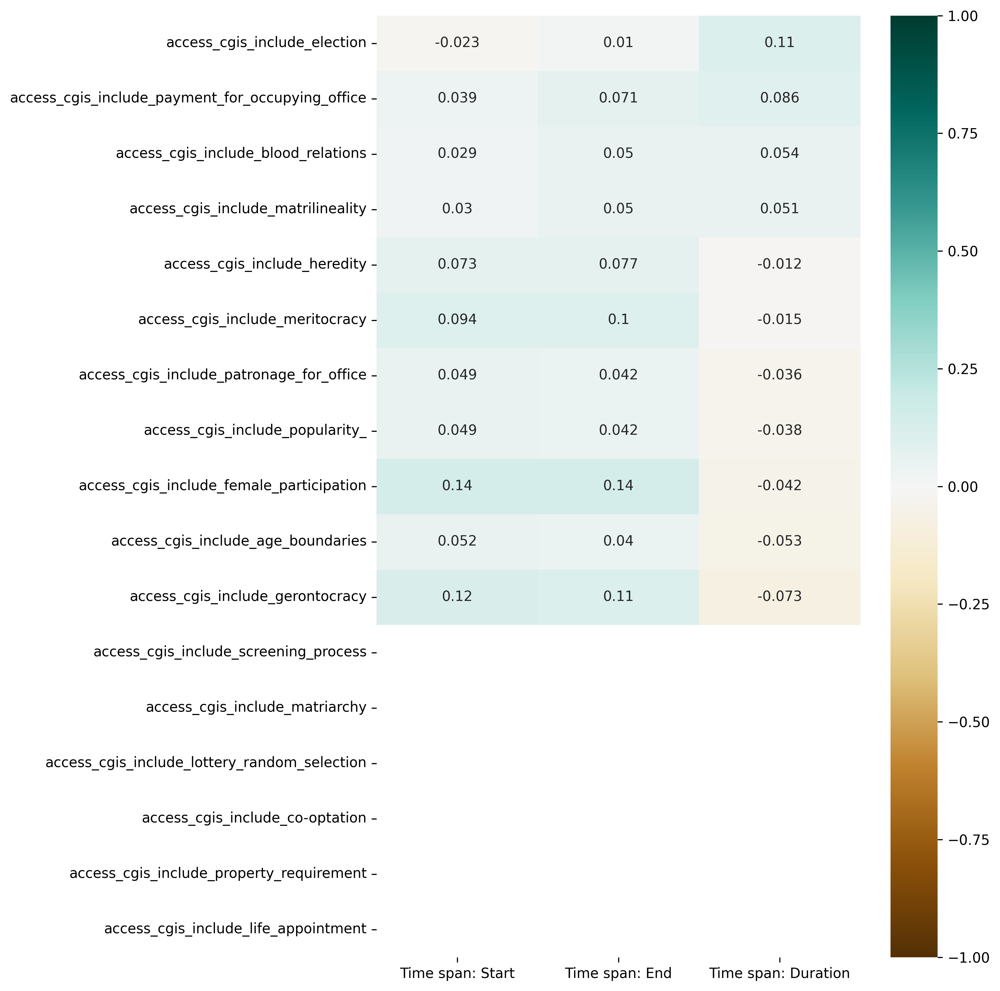

In [52]:
plt.figure(figsize=(10,10))

sns.heatmap(time_access_cgis.sort_values(by='Time span: Duration', ascending=False),
            vmin=-1, 
            vmax=1, 
            annot=True, 
            cmap='BrBG', 
            xticklabels=1, 
            yticklabels=1
)

plt.tight_layout()
plt.savefig(fig_dir + 'time_access_cgis.png')
plt.show()

In [53]:
time_decision_making_cgis = time_cgis.loc[decision_making_cgis]

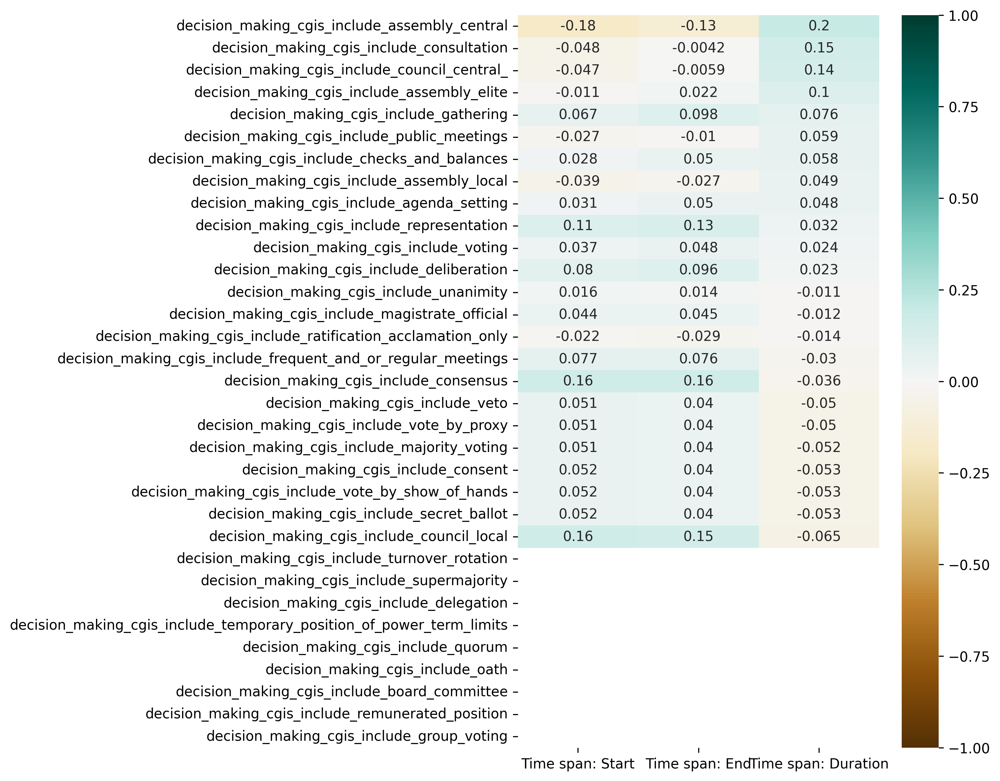

In [54]:
plt.figure(figsize=(10,8))

sns.heatmap(time_decision_making_cgis.sort_values(by='Time span: Duration', ascending=False),
            vmin=-1, 
            vmax=1, 
            annot=True, 
            cmap='BrBG', 
            xticklabels=1, 
            yticklabels=1
)

plt.tight_layout()
plt.savefig(fig_dir + 'time_decision_making_cgis.png')
plt.show()

In [55]:
time_enforcement_cgis = time_cgis.loc[enforcement_cgis]

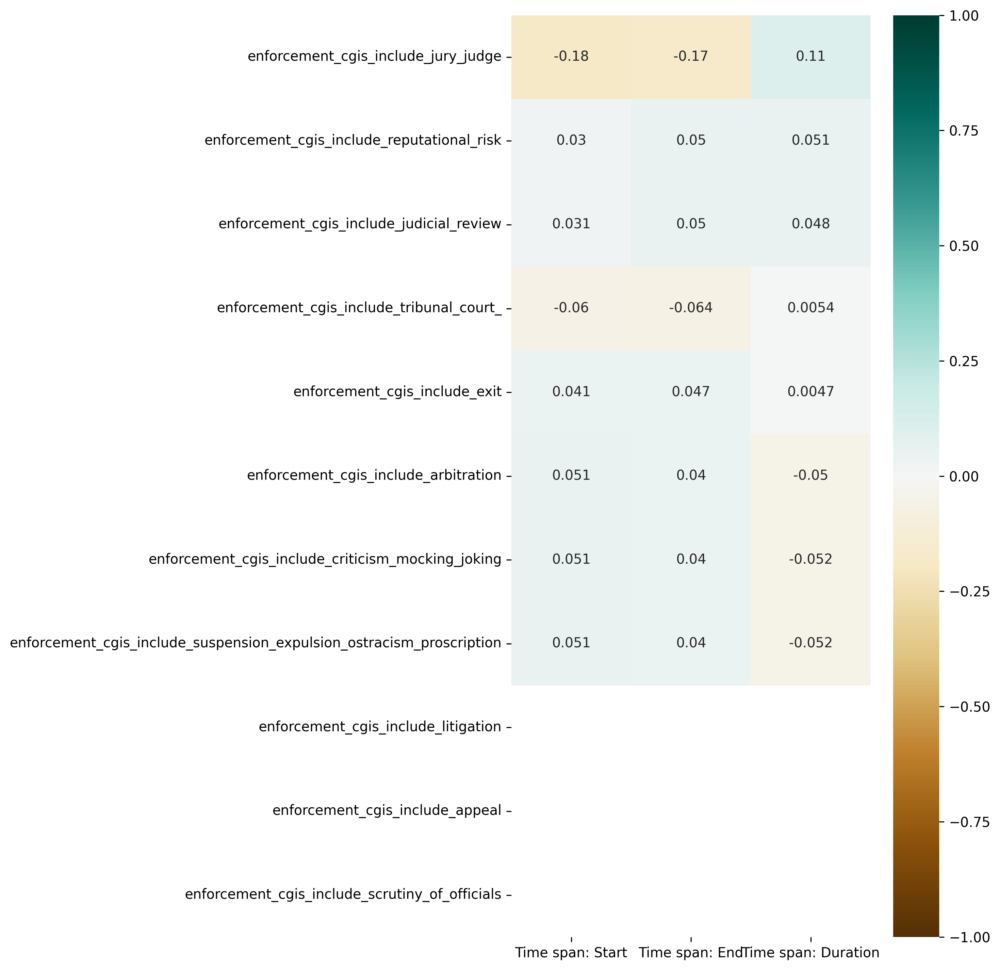

In [56]:
plt.figure(figsize=(10,10))

sns.heatmap(time_enforcement_cgis.sort_values(by='Time span: Duration', ascending=False),
            vmin=-1, 
            vmax=1, 
            annot=True, 
            cmap='BrBG', 
            xticklabels=1, 
            yticklabels=1
)

plt.tight_layout()
plt.savefig(fig_dir + 'time_enforcement_cgis.png')
plt.show()

## Region x CGIs

In [57]:
region_cgis = query_cgis_df[region_cols]
region_cgis

,Region: Africa,Region: Europe,Region: Asia,Region: Middle East,Region: North America,Region: Central America,Region: South America,Region: Oceania
access_cgis_include_age_boundaries,0.048387,NaN,-0.040953,-0.029716,-0.033075,-0.016144,-0.006532,-0.008019
enforcement_cgis_include_criticism_mocking_joking,-0.026698,NaN,0.066964,-0.029716,-0.033075,-0.016144,-0.006532,-0.008019
enforcement_cgis_include_reputational_risk,0.085379,NaN,-0.040953,-0.029716,-0.033075,-0.016144,-0.006532,-0.008019
decision_making_cgis_include_assembly_elite,0.001888,NaN,0.212214,-0.068071,-0.075766,-0.036982,-0.014964,0.134178
enforcement_cgis_include_litigation,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
decision_making_cgis_include_unanimity,-0.017813,NaN,-0.070255,-0.050978,0.072799,-0.027695,-0.011206,0.322107
access_cgis_include_meritocracy,-0.003181,NaN,-0.091557,-0.066435,0.075557,0.211956,-0.014604,-0.017927
enforcement_cgis_include_appeal,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
decision_making_cgis_include_consultation,-0.063590,NaN,0.081861,0.160733,0.086625,-0.038453,-0.015559,-0.019100
decision_making_cgis_include_ratification_acclamation_only,-0.037000,NaN,0.089005,0.033942,-0.045838,-0.022374,-0.009053,-0.011113


In [58]:
# Move Region: Europe to first col 
cols_to_move = ['Region: Europe']
region_cgis = region_cgis[cols_to_move + [col for col in region_cgis.columns if col not in cols_to_move ]]

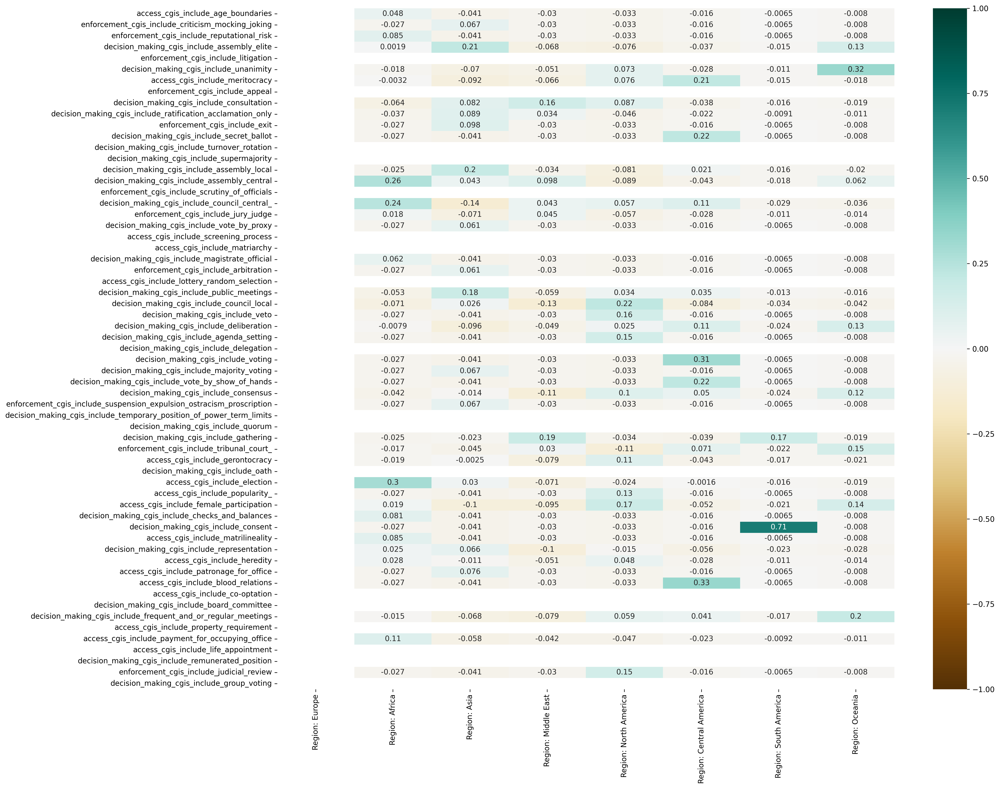

In [59]:
plt.figure(figsize=(20,15))

sns.heatmap(region_cgis.sort_values(by='Region: Europe', ascending=False),
            vmin=-1, 
            vmax=1, 
            annot=True, 
            cmap='BrBG', 
            xticklabels=1, 
            yticklabels=1
)

plt.tight_layout()
plt.savefig(fig_dir + 'cgis_region.png')
plt.show()

### Region x CGIs: Access, Decision Making, Enforcement

In [60]:
region_access_cgis = region_cgis.loc[access_cgis]

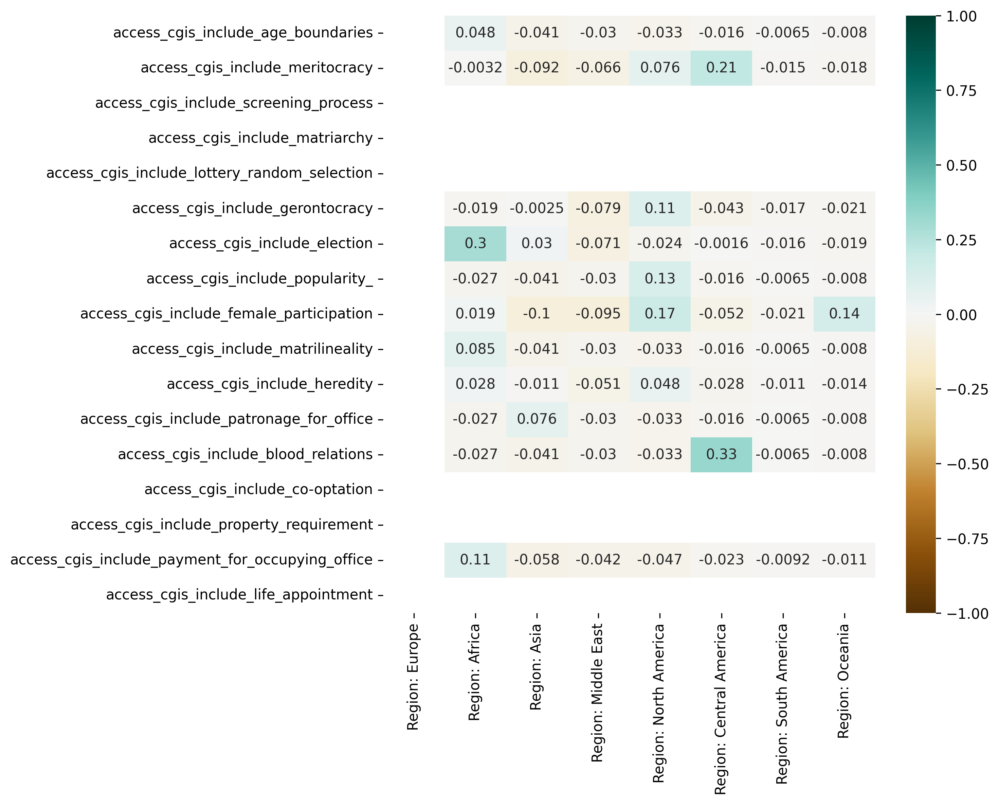

In [61]:
plt.figure(figsize=(10,8))

sns.heatmap(region_access_cgis.sort_values(by='Region: Europe', ascending=False),
            vmin=-1, 
            vmax=1, 
            annot=True, 
            cmap='BrBG', 
            xticklabels=1, 
            yticklabels=1
)

plt.tight_layout()
plt.savefig(fig_dir + 'region_access_cgis.png')
plt.show()

In [62]:
region_decision_making_cgis = region_cgis.loc[decision_making_cgis]

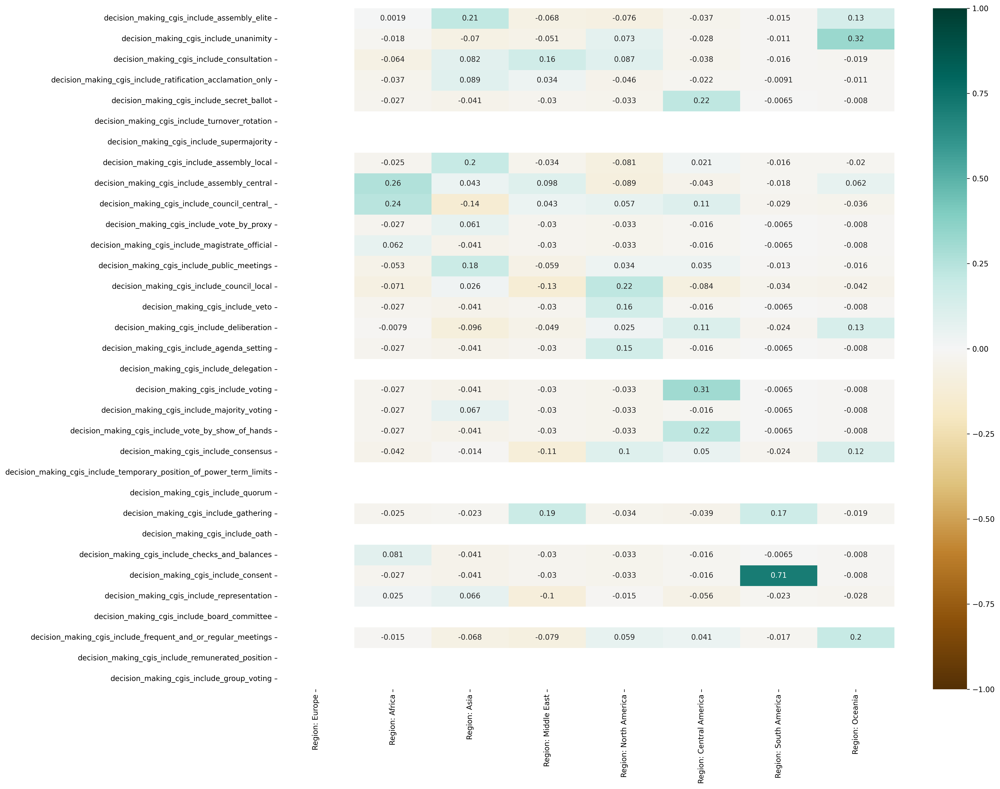

In [63]:
plt.figure(figsize=(20,15))

sns.heatmap(region_decision_making_cgis.sort_values(by='Region: Europe', ascending=False),
            vmin=-1, 
            vmax=1, 
            annot=True, 
            cmap='BrBG', 
            xticklabels=1, 
            yticklabels=1
)

plt.tight_layout()
plt.savefig(fig_dir + 'region_decision_making_cgis.png')
plt.show()

In [64]:
region_enforcement_cgis = region_cgis.loc[enforcement_cgis]

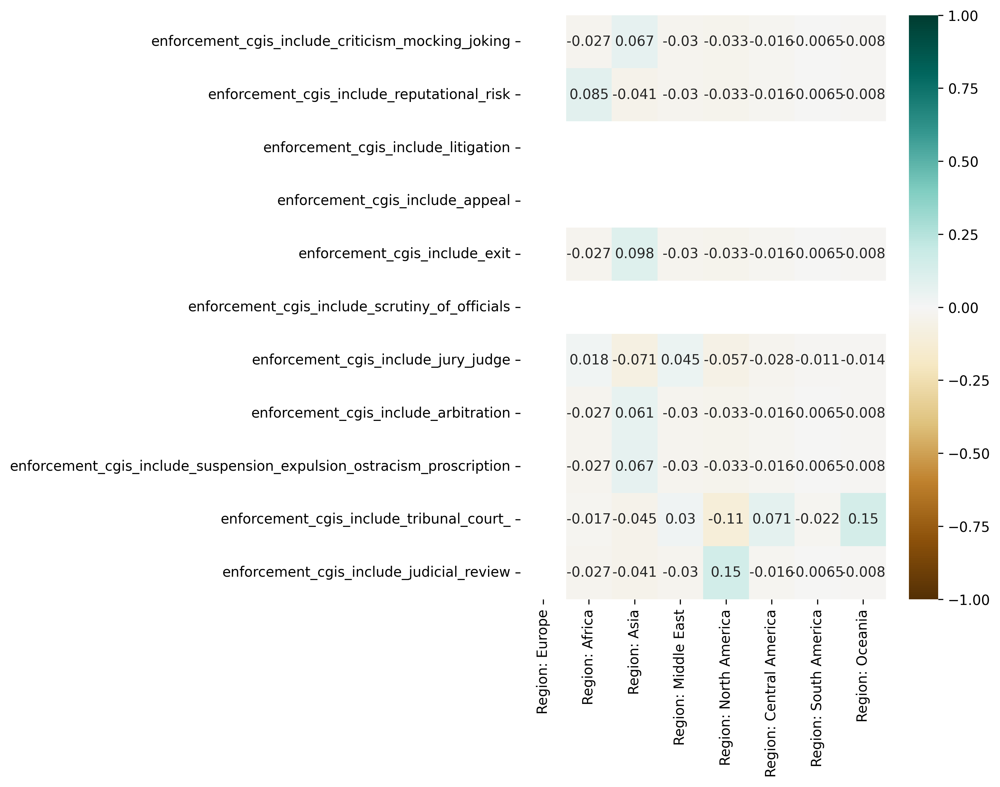

In [65]:
plt.figure(figsize=(10,8))

sns.heatmap(region_enforcement_cgis.sort_values(by='Region: Europe', ascending=False),
            vmin=-1, 
            vmax=1, 
            annot=True, 
            cmap='BrBG', 
            xticklabels=1, 
            yticklabels=1
)

plt.tight_layout()
plt.savefig(fig_dir + 'region_enforcement_cgis.png')
plt.show()

## Size x CGIs

In [66]:
size_cgis = query_cgis_df[size_cols]

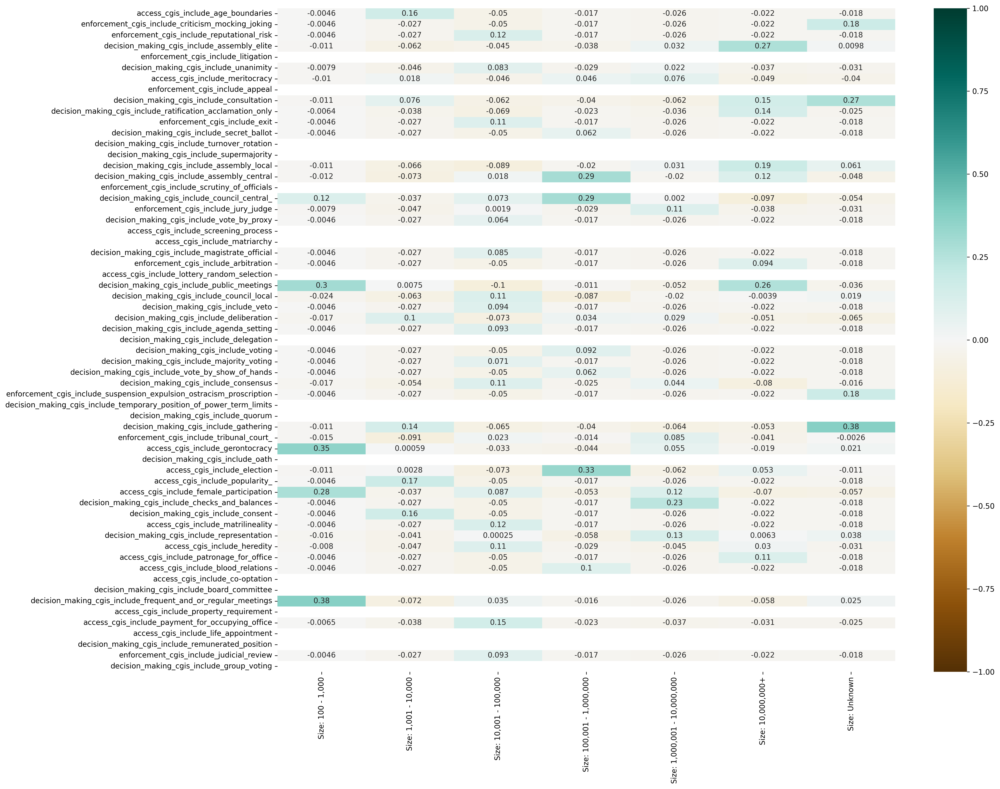

In [67]:
plt.figure(figsize=(20,15))

sns.heatmap(size_cgis,
            vmin=-1, 
            vmax=1, 
            annot=True, 
            cmap='BrBG', 
            xticklabels=1, 
            yticklabels=1
)

plt.tight_layout()
plt.savefig(fig_dir + 'cgis_size.png')
plt.show()

### Size x CGIs: Access, Decision Making, Enforcement

In [68]:
size_access_cgis = size_cgis.loc[access_cgis]

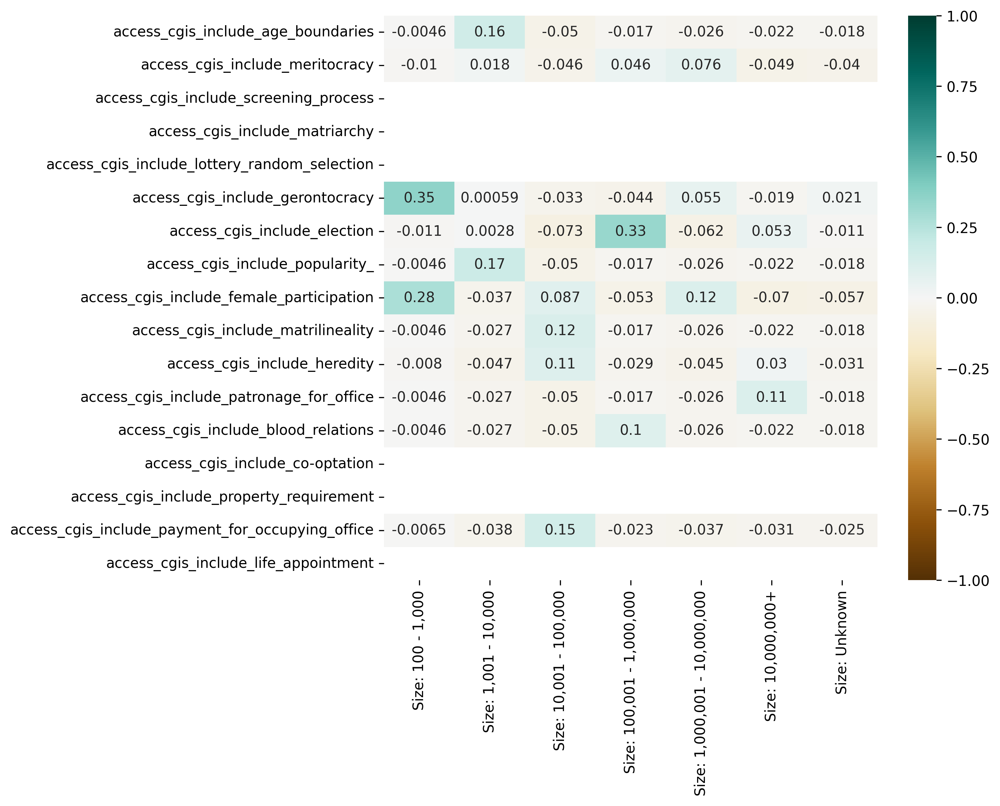

In [69]:
plt.figure(figsize=(10,8))

sns.heatmap(size_access_cgis,
            vmin=-1, 
            vmax=1, 
            annot=True, 
            cmap='BrBG', 
            xticklabels=1, 
            yticklabels=1
)

plt.tight_layout()
plt.savefig(fig_dir + 'size_access_cgis.png')
plt.show()

In [70]:
size_decision_making_cgis = size_cgis.loc[decision_making_cgis]

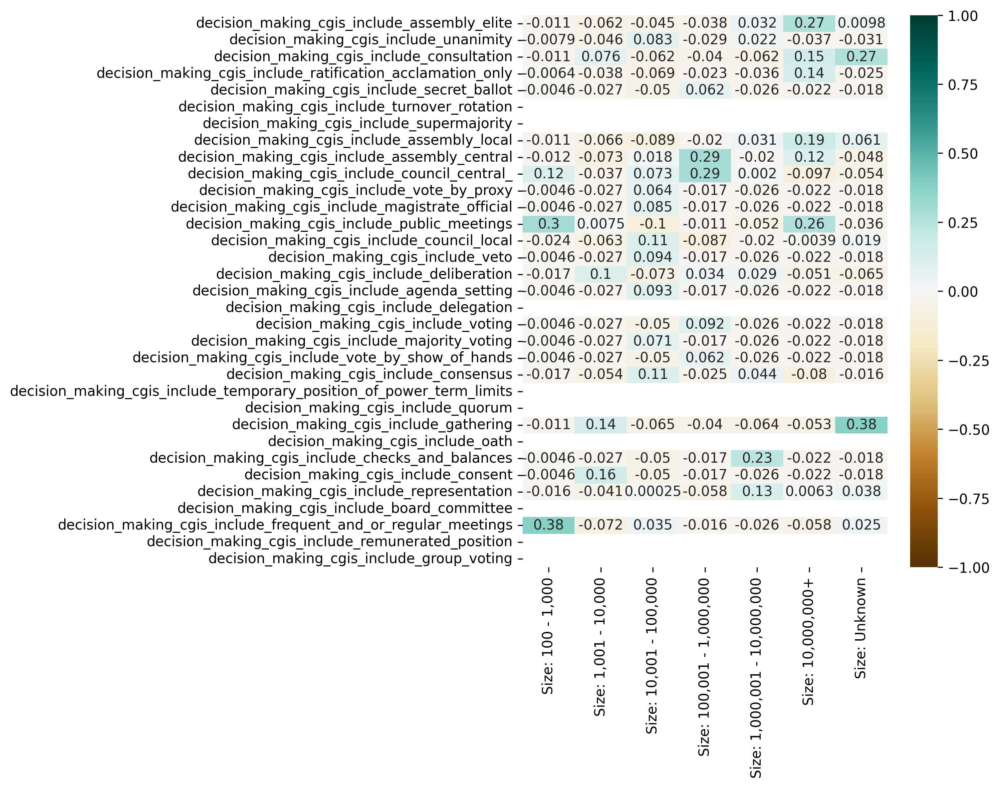

In [71]:
plt.figure(figsize=(10,8))

sns.heatmap(size_decision_making_cgis,
            vmin=-1, 
            vmax=1, 
            annot=True, 
            cmap='BrBG', 
            xticklabels=1, 
            yticklabels=1
)

plt.tight_layout()
plt.savefig(fig_dir + 'size_decision_making_cgis.png')
plt.show()

In [72]:
size_enforcement_cgis = size_cgis.loc[enforcement_cgis]

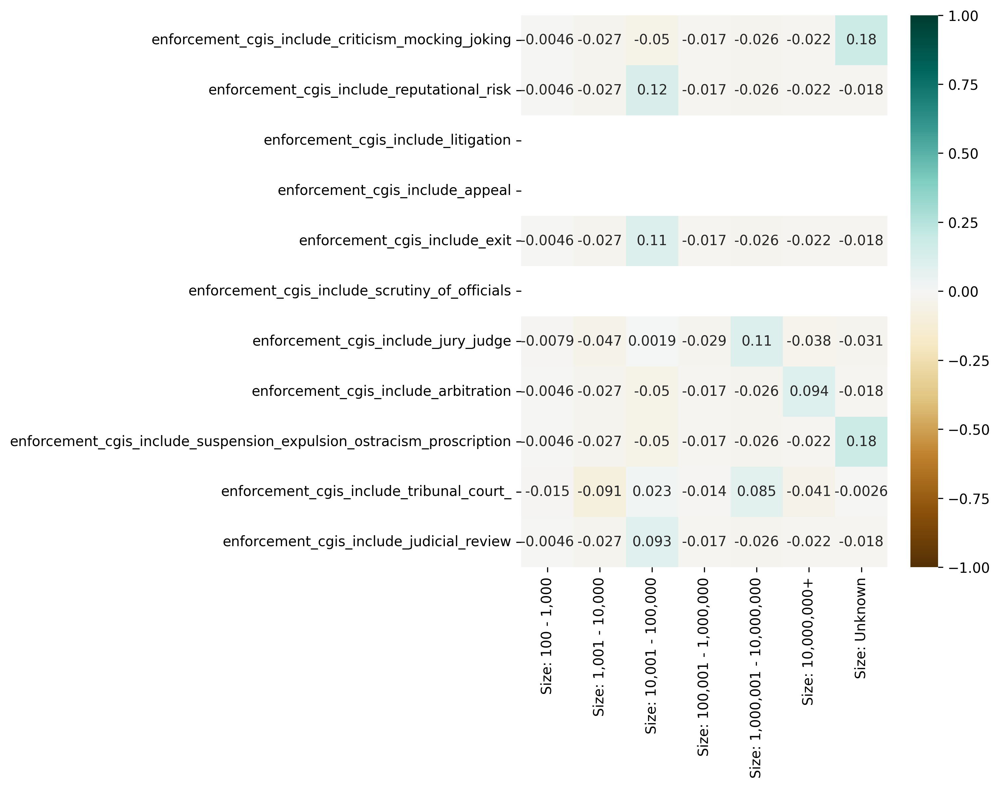

In [73]:
plt.figure(figsize=(10,8))

sns.heatmap(size_enforcement_cgis,
            vmin=-1, 
            vmax=1, 
            annot=True, 
            cmap='BrBG', 
            xticklabels=1, 
            yticklabels=1
)

plt.tight_layout()
plt.savefig(fig_dir + 'size_enforcement_cgis.png')
plt.show()

# Sorted positive and negative correlations

In [74]:
def get_redundant_pairs(df):
    '''Get diagonal and lower triangular pairs of correlation matrix'''
    pairs_to_drop = set()
    cols = df.columns
    for i in range(0, df.shape[1]):
        for j in range(0, i+1):
            pairs_to_drop.add((cols[i], cols[j]))
    return pairs_to_drop

In [75]:
def get_sorted_correlations(corr_df, n=100, ascending=False):
    au_corr = corr_df.unstack()
    labels_to_drop = get_redundant_pairs(corr_df)
    au_corr = au_corr.drop(labels=labels_to_drop).sort_values(ascending=ascending)
    return au_corr

In [76]:
# Highest 200 positively correlated variables
print(get_sorted_correlations(norm_corr, n=200, ascending=False))

decision_making_mechanisms_include_lobbying        Geography: Africa West, Mid-western Nigeria                            1.0
decision_making_mechanisms_include_power_fluidity  Region: South America                                                  1.0
decision_making_mechanisms_include_lobbying        decision_making_mechanisms_include_president_consul_chief_executive    1.0
decision_making_mechanisms_include_secret_ballot   decision_making_mechanisms_include_vote_by_show_of_hands               1.0
enforcement_mechanisms_include_forced_labour       Geography: Africa North                                                1.0
                                                                                                                         ... 
access_cgis_include_life_appointment               enforcement_cgis_include_judicial_review                               NaN
                                                   decision_making_cgis_include_group_voting                          

In [77]:
get_sorted_correlations(norm_corr, n=200, ascending=False).to_csv('../csv/v2/cgis_all_correlations.csv')

In [78]:
# Highest 200 negatively correlated variables 
print(get_sorted_correlations(norm_corr, n=200, ascending=True))

Time span: End                                     enforcement_mechanisms_include_jury_judge   -0.656431
                                                   Region: Middle East                         -0.644804
Time span: Start                                   enforcement_mechanisms_include_jury_judge   -0.636932
Time span: End                                     Geography: Middle East                      -0.611567
Time span: Start                                   Region: Middle East                         -0.597030
                                                                                                  ...   
access_cgis_include_life_appointment               enforcement_cgis_include_judicial_review          NaN
                                                   decision_making_cgis_include_group_voting         NaN
decision_making_cgis_include_remunerated_position  enforcement_cgis_include_judicial_review          NaN
                                                   deci

In [79]:
get_sorted_correlations(norm_corr, n=200, ascending=True).to_csv('../csv/v2/cgis_negative_correlations.csv')